In [1]:
!pip install datasets

# 1. Importing All Libraries


In [2]:
import os
from zipfile import ZipFile
import re
import sys
import nltk
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import tree
from sklearn.svm import SVC
from joblib import dump, load
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from keras.models import Sequential,Model
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from keras.layers import Dense,LSTM, SpatialDropout1D, Embedding
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from transformers import (
    AutoTokenizer,
    AutoModelForSequenceClassification,
    TrainingArguments,
    Trainer
)
import torch
from datasets import Dataset
import nltk
from nltk.corpus import stopwords
import re
import json
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# 2. Reading the dataset

In [ ]:
os.environ['KAGGLE_USERNAME'] = 'your-name'
os.environ['KAGGLE_KEY'] = 'Your-API-Key'

!kaggle datasets download -d snehaanbhawal/resume-dataset

Dataset URL: https://www.kaggle.com/datasets/snehaanbhawal/resume-dataset
License(s): CC0-1.0
resume-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [4]:
with ZipFile('resume-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('resume')

In [5]:
df = pd.read_csv('/content/resume/Resume/Resume.csv')
df

,ID,Resume_str,Resume_html,Category
0,16852973,HR ADMINISTRATOR/MARKETING ASSOCIATE\...,"<div class=""fontsize fontface vmargins hmargin...",HR
1,22323967,"HR SPECIALIST, US HR OPERATIONS ...","<div class=""fontsize fontface vmargins hmargin...",HR
2,33176873,HR DIRECTOR Summary Over 2...,"<div class=""fontsize fontface vmargins hmargin...",HR
3,27018550,HR SPECIALIST Summary Dedica...,"<div class=""fontsize fontface vmargins hmargin...",HR
4,17812897,HR MANAGER Skill Highlights ...,"<div class=""fontsize fontface vmargins hmargin...",HR
...,...,...,...,...
2479,99416532,RANK: SGT/E-5 NON- COMMISSIONED OFFIC...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION
2480,24589765,"GOVERNMENT RELATIONS, COMMUNICATIONS ...","<div class=""fontsize fontface vmargins hmargin...",AVIATION
2481,31605080,GEEK SQUAD AGENT Professional...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION
2482,21190805,PROGRAM DIRECTOR / OFFICE MANAGER ...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION


# 3. List off all Categories

In [6]:
for i in range(len(df['Category'].unique())):
    print(df['Category'].unique()[i])

HR
DESIGNER
INFORMATION-TECHNOLOGY
TEACHER
ADVOCATE
BUSINESS-DEVELOPMENT
HEALTHCARE
FITNESS
AGRICULTURE
BPO
SALES
CONSULTANT
DIGITAL-MEDIA
AUTOMOBILE
CHEF
FINANCE
APPAREL
ENGINEERING
ACCOUNTANT
CONSTRUCTION
PUBLIC-RELATIONS
BANKING
ARTS
AVIATION


# Count the Categories

In [7]:
df["Category"].value_counts()

,count
Category,
INFORMATION-TECHNOLOGY,120
BUSINESS-DEVELOPMENT,120
FINANCE,118
ADVOCATE,118
ACCOUNTANT,118
ENGINEERING,118
CHEF,118
AVIATION,117
FITNESS,117


# 4. Visualizing most commonly used words in each type of Resumes

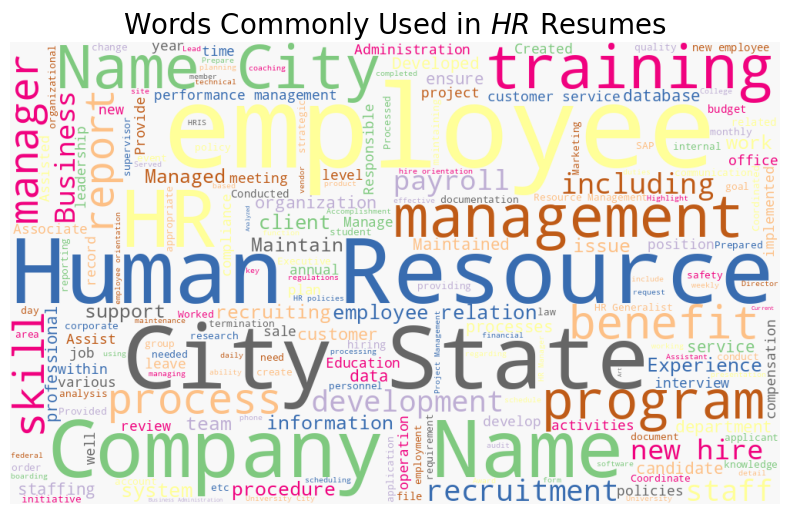

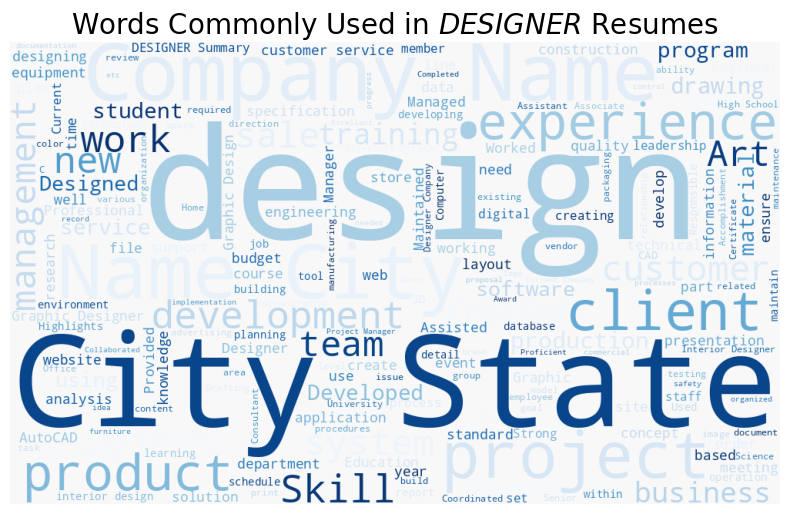

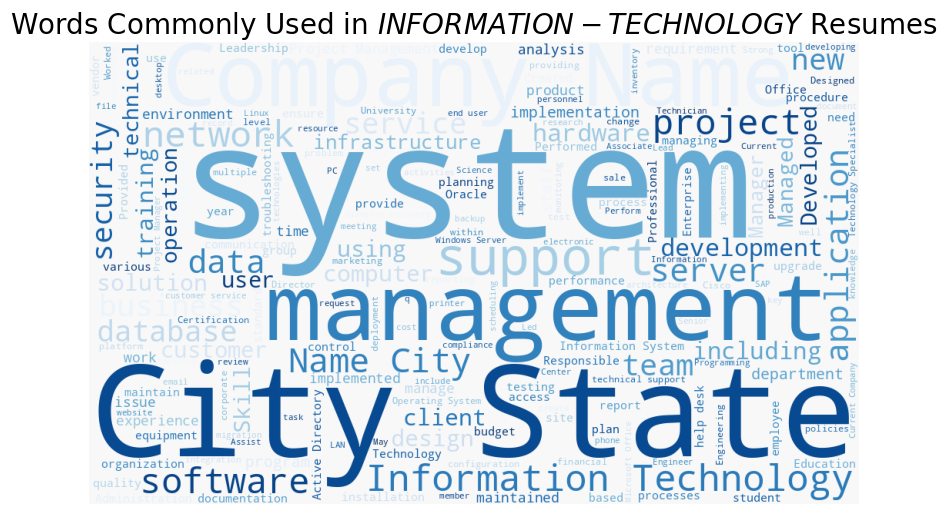

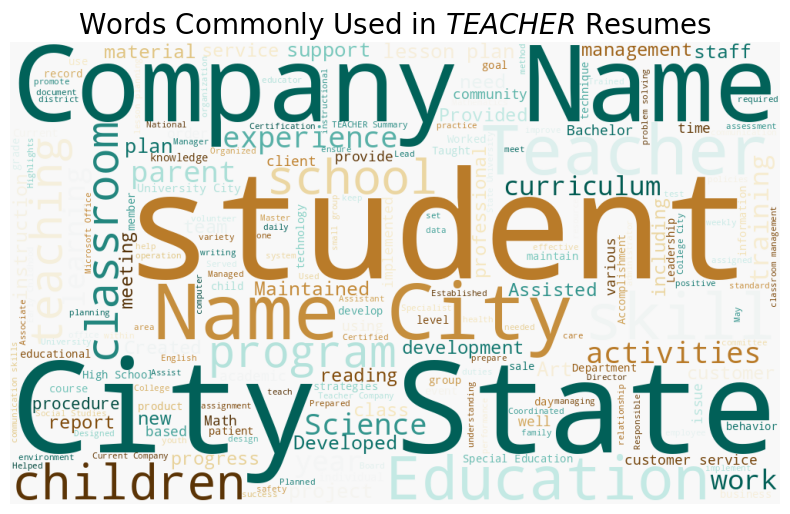

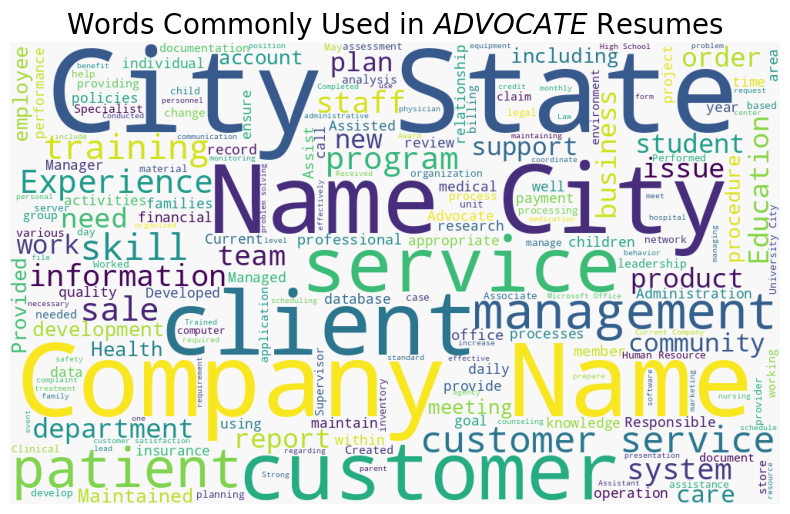

...

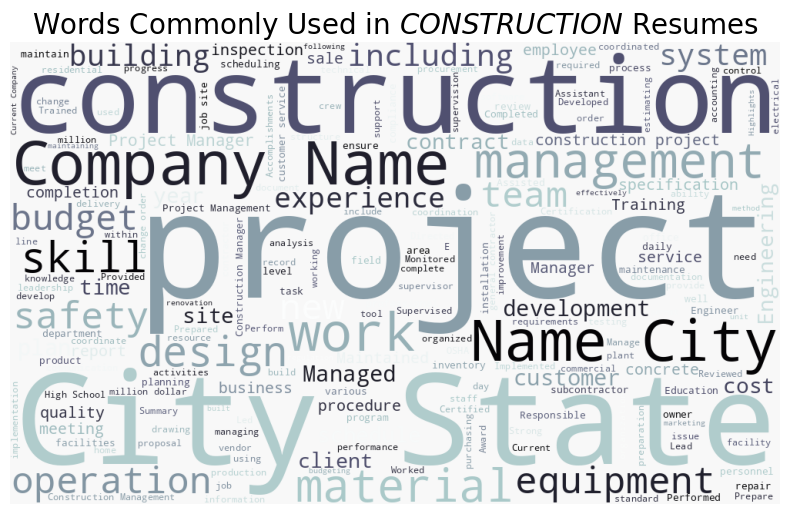

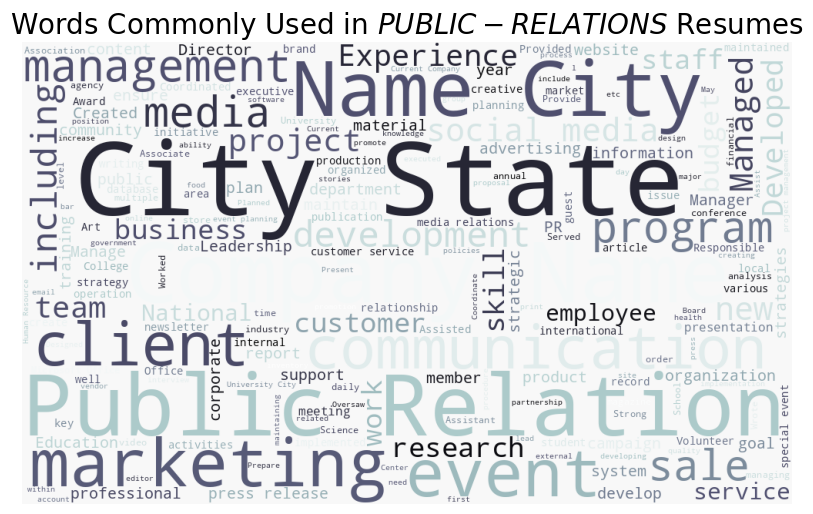

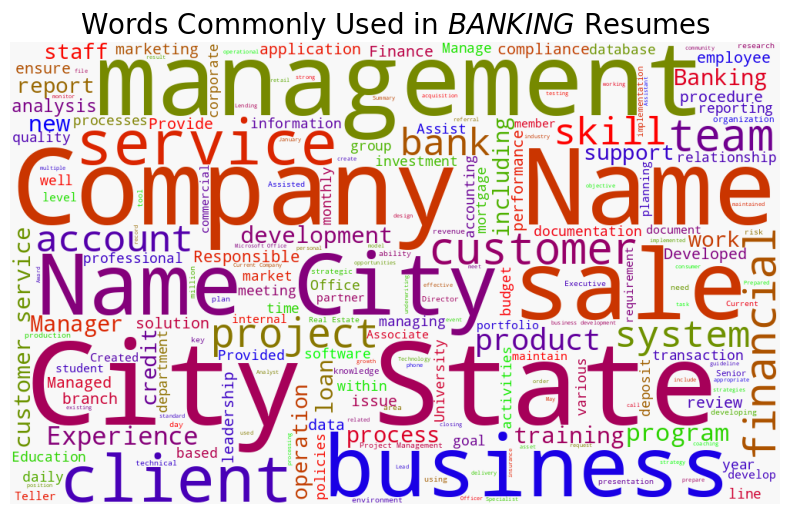

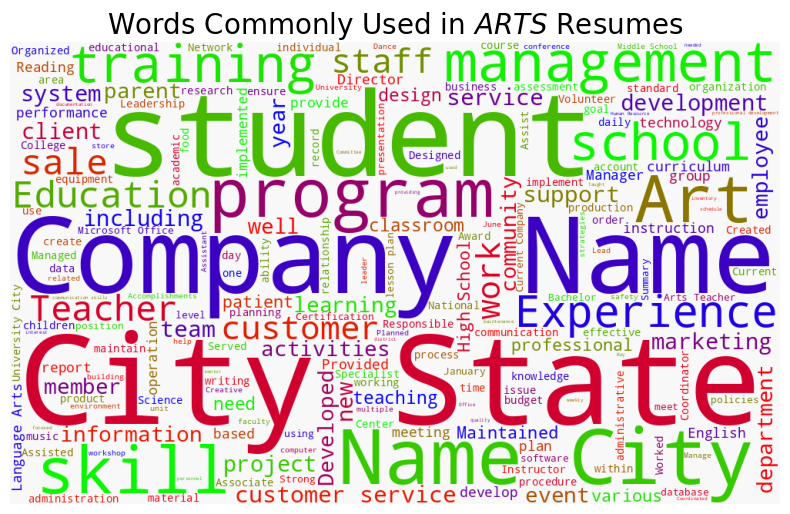

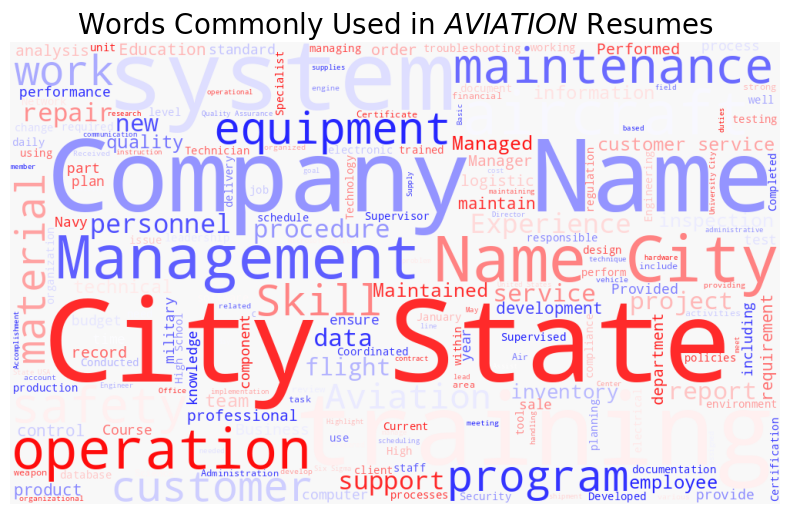

In [8]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume_str"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

# 5. Pre Processing

# Check the Null Value


In [9]:
print(df.isnull().sum())

ID             0
Resume_str     0
Resume_html    0
Category       0
dtype: int64


# Converting the data into lower case and removing words with small lengths

In [10]:
df['Resume_str'] = df['Resume_str'].apply(lambda x:x.lower())
for i in range(len(df)):
    lw=[]
    for j in df['Resume_str'][i].split():
        if len(j)>=3:
            lw.append(j)
    df['Resume_str'][i]=" ".join(lw)
df

Streaming output truncated to the last 5000 lines.
See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Resume_str'][i]=" ".join(lw)
<ipython-input-10-c07329901285>:7: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/s

,ID,Resume_str,Resume_html,Category
0,16852973,administrator/marketing associate administrato...,"<div class=""fontsize fontface vmargins hmargin...",HR
1,22323967,"specialist, operations summary versatile media...","<div class=""fontsize fontface vmargins hmargin...",HR
2,33176873,director summary over years experience recruit...,"<div class=""fontsize fontface vmargins hmargin...",HR
3,27018550,"specialist summary dedicated, driven, and dyna...","<div class=""fontsize fontface vmargins hmargin...",HR
4,17812897,manager skill highlights skills department sta...,"<div class=""fontsize fontface vmargins hmargin...",HR
...,...,...,...,...
2479,99416532,rank: sgt/e-5 non- commissioned officer charge...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION
2480,24589765,"government relations, communications and organ...","<div class=""fontsize fontface vmargins hmargin...",AVIATION
2481,31605080,geek squad agent professional profile support ...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION
2482,21190805,program director office manager summary highly...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION


# Removing Special Characters

In [11]:
df['Cleaned_Resume_str'] = df['Resume_str'].apply(lambda x: re.sub(r'[^a-zA-Z0-9\s]', '', x))

df

,ID,Resume_str,Resume_html,Category,Cleaned_Resume_str
0,16852973,administrator/marketing associate administrato...,"<div class=""fontsize fontface vmargins hmargin...",HR,administratormarketing associate administrator...
1,22323967,"specialist, operations summary versatile media...","<div class=""fontsize fontface vmargins hmargin...",HR,specialist operations summary versatile media ...
2,33176873,director summary over years experience recruit...,"<div class=""fontsize fontface vmargins hmargin...",HR,director summary over years experience recruit...
3,27018550,"specialist summary dedicated, driven, and dyna...","<div class=""fontsize fontface vmargins hmargin...",HR,specialist summary dedicated driven and dynami...
4,17812897,manager skill highlights skills department sta...,"<div class=""fontsize fontface vmargins hmargin...",HR,manager skill highlights skills department sta...
...,...,...,...,...,...
2479,99416532,rank: sgt/e-5 non- commissioned officer charge...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,rank sgte5 non commissioned officer charge bri...
2480,24589765,"government relations, communications and organ...","<div class=""fontsize fontface vmargins hmargin...",AVIATION,government relations communications and organi...
2481,31605080,geek squad agent professional profile support ...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,geek squad agent professional profile support ...
2482,21190805,program director office manager summary highly...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,program director office manager summary highly...


# Removing '\n' and '\t', extra spaces, quoting text and progressive pronouns

In [12]:
df['Resume_str'] = df['Resume_str'].str.replace("    ", " ")
df['Resume_str'] = df['Resume_str'].str.replace('"', '')
df['Resume_str'] = df['Resume_str'].apply(lambda x: x.replace('\t', ' '))
df['Resume_str'] = df['Resume_str'].str.replace("'s", "")
df['Resume_str'] = df['Resume_str'].apply(lambda x: x.replace('\n', ' '))
df

,ID,Resume_str,Resume_html,Category,Cleaned_Resume_str
0,16852973,administrator/marketing associate administrato...,"<div class=""fontsize fontface vmargins hmargin...",HR,administratormarketing associate administrator...
1,22323967,"specialist, operations summary versatile media...","<div class=""fontsize fontface vmargins hmargin...",HR,specialist operations summary versatile media ...
2,33176873,director summary over years experience recruit...,"<div class=""fontsize fontface vmargins hmargin...",HR,director summary over years experience recruit...
3,27018550,"specialist summary dedicated, driven, and dyna...","<div class=""fontsize fontface vmargins hmargin...",HR,specialist summary dedicated driven and dynami...
4,17812897,manager skill highlights skills department sta...,"<div class=""fontsize fontface vmargins hmargin...",HR,manager skill highlights skills department sta...
...,...,...,...,...,...
2479,99416532,rank: sgt/e-5 non- commissioned officer charge...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,rank sgte5 non commissioned officer charge bri...
2480,24589765,"government relations, communications and organ...","<div class=""fontsize fontface vmargins hmargin...",AVIATION,government relations communications and organi...
2481,31605080,geek squad agent professional profile support ...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,geek squad agent professional profile support ...
2482,21190805,program director office manager summary highly...,"<div class=""fontsize fontface vmargins hmargin...",AVIATION,program director office manager summary highly...


# Applying Lemmatiazation

In [13]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [14]:
wl = WordNetLemmatizer()
nr = len(df)
lis = []
for r in range(0, nr):
    ll = []
    t = df.loc[r]['Resume_str']
    tw = str(t).split(" ")
    for w in tw:
        ll.append(wl.lemmatize(w, pos="v"))
    lt = " ".join(ll)
    lis.append(lt)

In [15]:
df['Resume_str'] = lis

In [16]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [17]:
sw = list(stopwords.words('english'))
for s in sw:
    rs = r"\b" + s + r"\b"
    df['Resume_str'] = df['Resume_str'].str.replace(rs, '')

# Visualizing most commonly used words in Resumes after applying NLP techniques

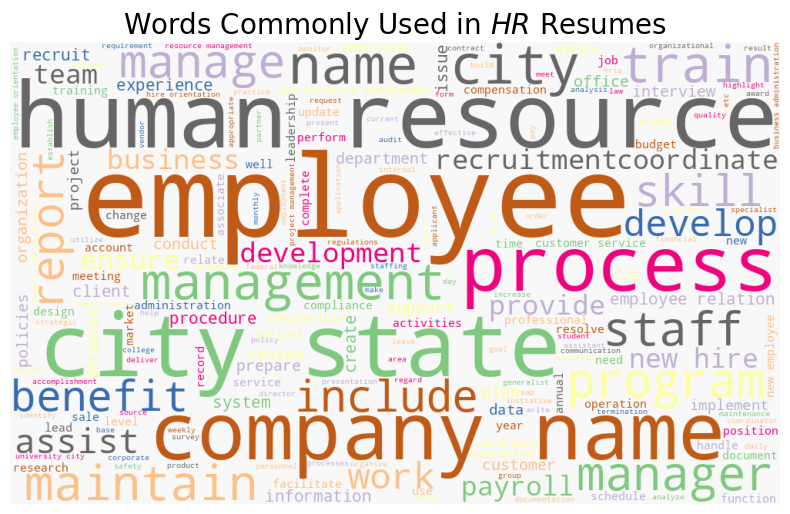

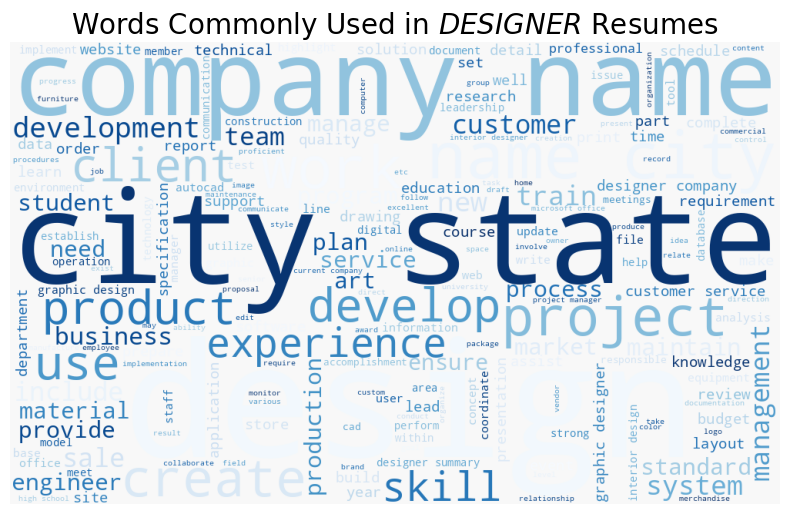

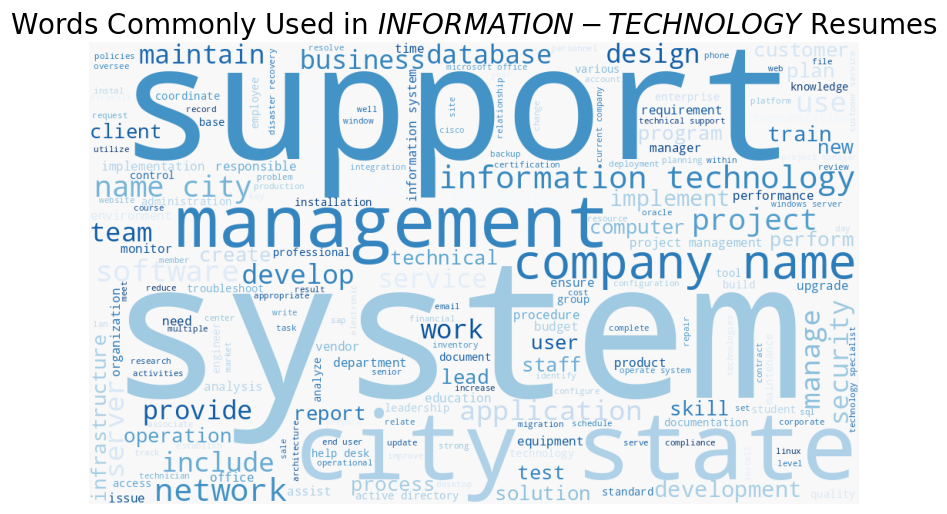

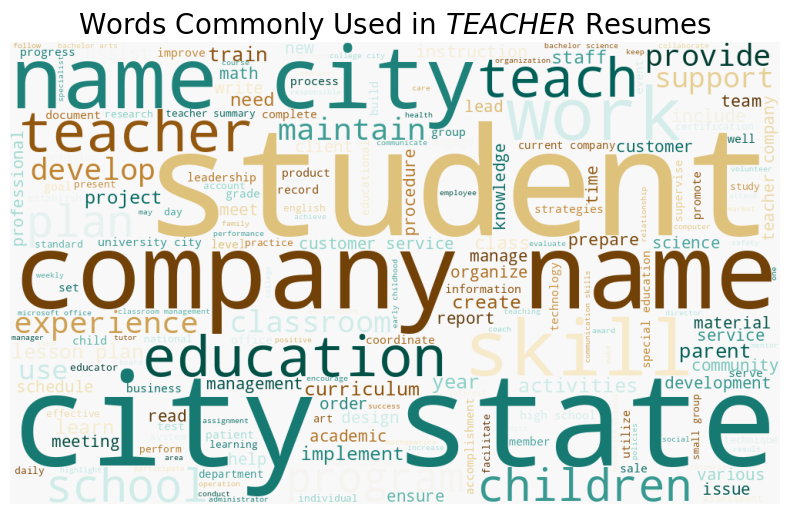

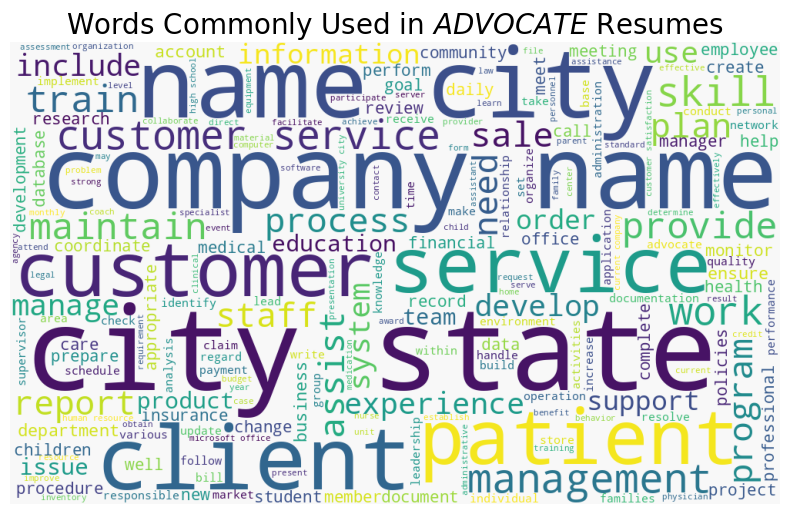

...

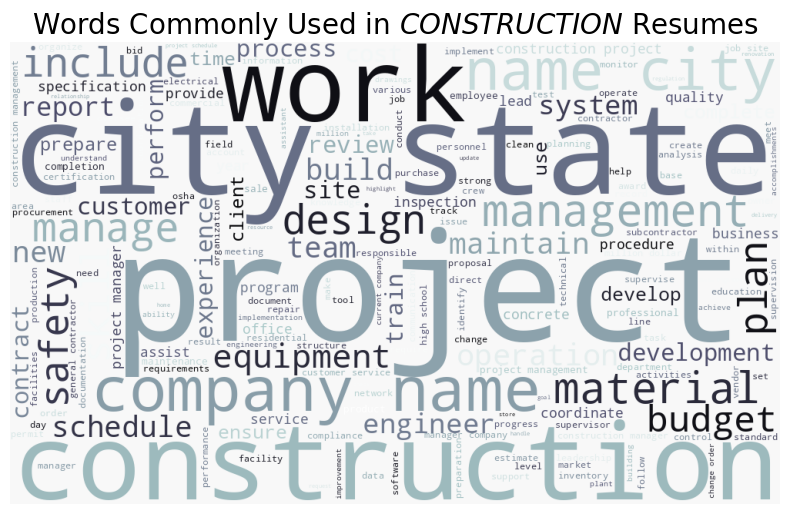

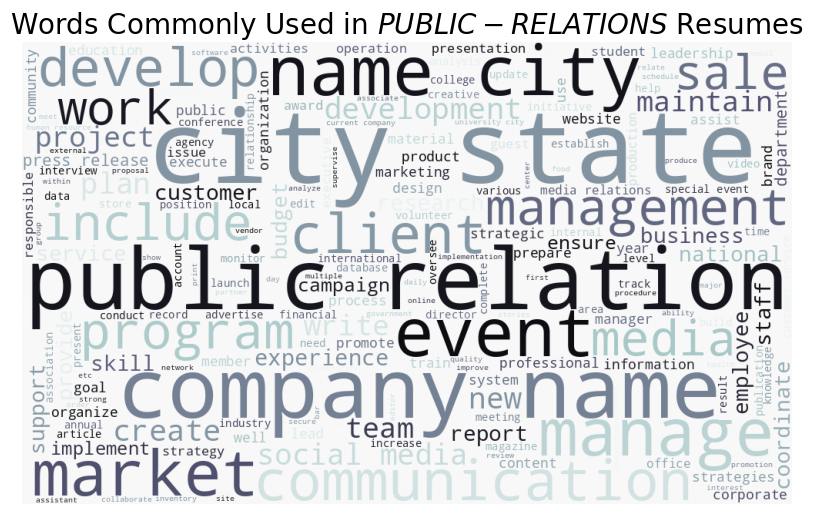

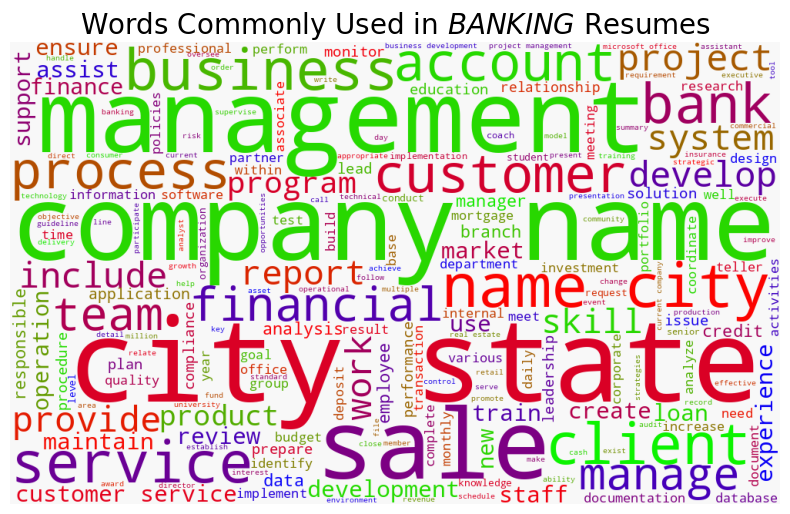

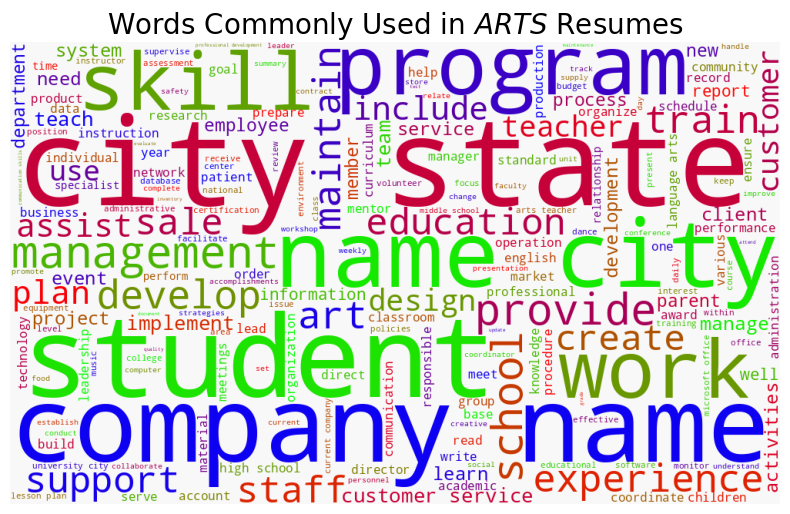

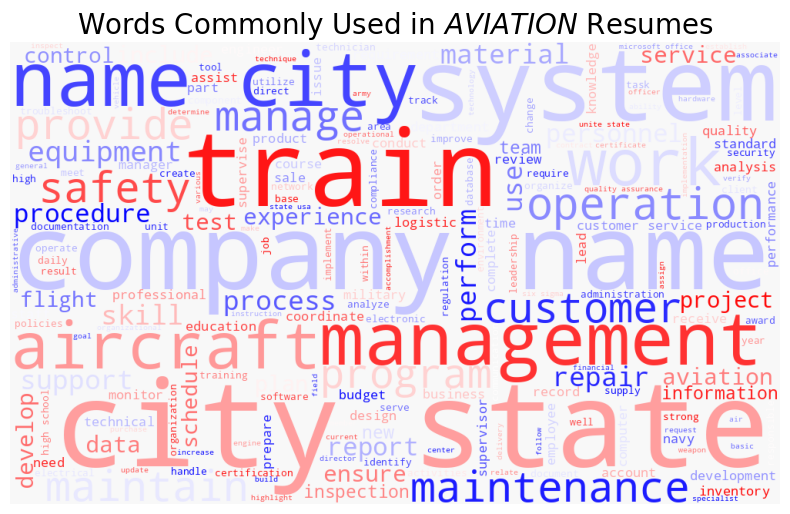

In [18]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r','Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume_str"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

In [19]:
!pip install transformers torch datasets pandas scikit-learn seaborn matplotlib

In [20]:
!pip install evaluate

Loading data...
Initializing DistilBERT classifier...
Preparing dataset...


Map:   0%|          | 0/2484 [00:00<?, ? examples/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Splitting dataset...
Training model with 24 categories...


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Starting training...


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,2.562428,0.610553
2,No log,1.869219,0.718593
3,No log,1.686893,0.733668


Training completed!
Evaluating model...

Evaluating model...



Classification Report:
                        precision    recall  f1-score   support

            ACCOUNTANT       0.92      0.96      0.94        25
              ADVOCATE       0.45      0.79      0.58        24
           AGRICULTURE       1.00      0.12      0.22         8
               APPAREL       0.00      0.00      0.00        15
                  ARTS       1.00      0.05      0.09        21
            AUTOMOBILE       0.00      0.00      0.00         7
              AVIATION       0.61      0.74      0.67        23
               BANKING       0.79      0.44      0.56        25
                   BPO       0.00      0.00      0.00         3
  BUSINESS-DEVELOPMENT       0.86      0.95      0.90        19
                  CHEF       0.79      0.79      0.79        29
          CONSTRUCTION       0.95      0.91      0.93        23
            CONSULTANT       0.88      1.00      0.93        28
              DESIGNER       0.76      1.00      0.87        26
         DIGITA

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

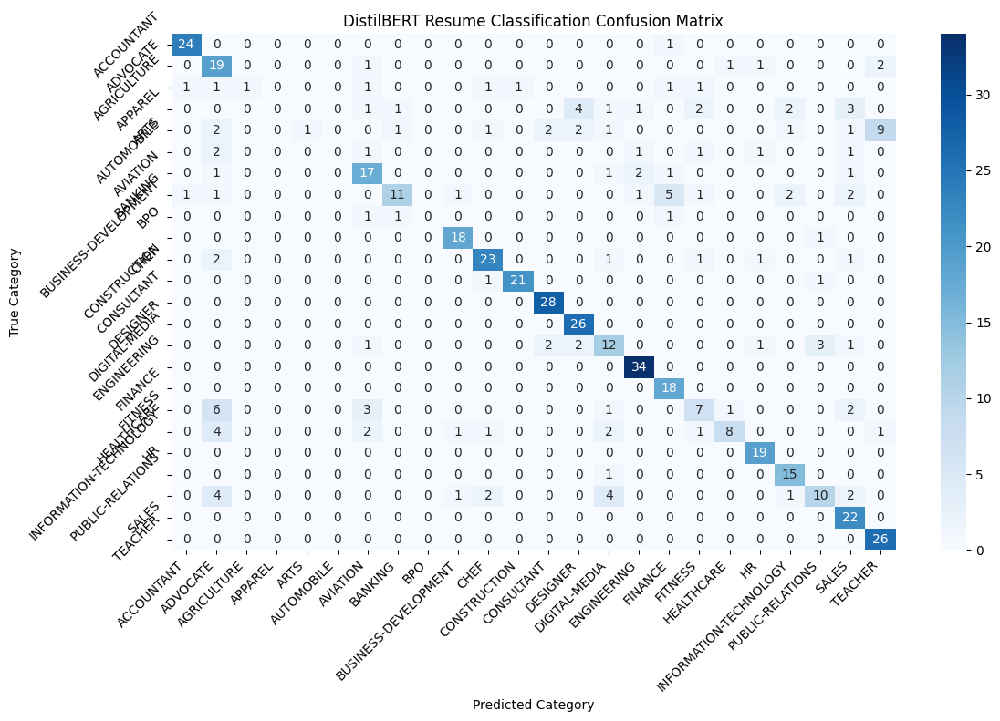


Making sample prediction...
Sample Resume Prediction:
Predicted Category: HR
Confidence: 44.52%

Confidence Scores for All Categories:
ACCOUNTANT: 2.57%
ADVOCATE: 3.02%
AGRICULTURE: 2.63%
APPAREL: 3.72%
ARTS: 2.35%
AUTOMOBILE: 1.68%
AVIATION: 2.35%
BANKING: 1.63%
BPO: 2.22%
BUSINESS-DEVELOPMENT: 1.37%
CHEF: 2.45%
CONSTRUCTION: 2.29%
CONSULTANT: 2.18%
DESIGNER: 2.34%
DIGITAL-MEDIA: 2.54%
ENGINEERING: 2.17%
FINANCE: 2.82%
FITNESS: 3.18%
HEALTHCARE: 2.64%
HR: 44.52%
INFORMATION-TECHNOLOGY: 2.16%
PUBLIC-RELATIONS: 3.42%
SALES: 2.10%
TEACHER: 1.65%

Testing relevance classification...

Single Resume Relevance:
Category: Not Relevant
Similarity Score: 2.78%

Batch Classification Results:
   resume_index relevance_category  similarity_score
0             0       Not Relevant          0.027754
1             1       Not Relevant          0.026523
2             2       Not Relevant          0.033591
3             3       Not Relevant          0.031336
4             4       Not Relevant         

In [37]:
import pandas as pd
import numpy as np
from transformers import (
    DistilBertTokenizer,
    DistilBertForSequenceClassification,
    TrainingArguments,
    Trainer
)
import torch
from datasets import Dataset
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import evaluate
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

class DistilBERTResumeClassifier:
    def __init__(self):
        self.model_name = "distilbert-base-uncased"
        self.tokenizer = DistilBertTokenizer.from_pretrained(self.model_name)
        self.label_encoder = LabelEncoder()
        self.metric = evaluate.load("accuracy")
        self.tfidf_vectorizer = TfidfVectorizer(
            max_features=5000,
            stop_words='english',
            ngram_range=(1, 2)
        )

    def compute_metrics(self, eval_pred):
        predictions, labels = eval_pred
        predictions = np.argmax(predictions, axis=1)
        return self.metric.compute(predictions=predictions, references=labels)

    def prepare_dataset(self, df):
        """
        Prepare dataset for DistilBERT with proper label handling
        """
        # Encode labels
        self.label_encoder.fit(df['Category'])
        encoded_labels = self.label_encoder.transform(df['Category'])

        # Create dataset dictionary
        dataset_dict = {
            'text': df['Resume_str'].tolist(),
            'labels': encoded_labels.tolist()
        }

        # Convert to Hugging Face Dataset
        dataset = Dataset.from_dict(dataset_dict)

        def tokenize_and_encode(examples):
            tokenized = self.tokenizer(
                examples['text'],
                padding='max_length',
                truncation=True,
                max_length=128
            )
            # Include labels in the tokenized output
            tokenized['labels'] = examples['labels']
            return tokenized

        # Tokenize dataset and keep labels
        tokenized_dataset = dataset.map(
            tokenize_and_encode,
            remove_columns=dataset.column_names,
            batched=True
        )

        return tokenized_dataset

    def train_model(self, train_dataset, val_dataset, num_labels, output_dir="./distilbert_results"):
        self.model = DistilBertForSequenceClassification.from_pretrained(
            self.model_name,
            num_labels=num_labels
        )

        training_args = TrainingArguments(
            output_dir=output_dir,
            learning_rate=2e-5,
            per_device_train_batch_size=16,
            per_device_eval_batch_size=16,
            num_train_epochs=3,
            weight_decay=0.01,
            evaluation_strategy="epoch",
            save_strategy="epoch",
            load_best_model_at_end=True,
            push_to_hub=False,
            report_to="none"
        )

        self.trainer = Trainer(
            model=self.model,
            args=training_args,
            train_dataset=train_dataset,
            eval_dataset=val_dataset,
            compute_metrics=self.compute_metrics
        )

        print("Starting training...")
        self.trainer.train()
        print("Training completed!")

    def evaluate_model(self, test_dataset):
        """
        Evaluate model performance with detailed metrics
        """
        print("\nEvaluating model...")
        predictions = self.trainer.predict(test_dataset)
        preds = np.argmax(predictions.predictions, axis=1)
        true_labels = test_dataset['labels']

        # Decode labels
        pred_categories = self.label_encoder.inverse_transform(preds)
        true_categories = self.label_encoder.inverse_transform(true_labels)

        # Classification Report
        print("\nClassification Report:")
        report = classification_report(
            true_categories,
            pred_categories,
            target_names=self.label_encoder.classes_,
            output_dict=True
        )
        print(classification_report(true_categories, pred_categories, target_names=self.label_encoder.classes_))

        # Metrics from the report
        accuracy = report["accuracy"]
        precision = report["weighted avg"]["precision"]
        recall = report["weighted avg"]["recall"]
        f1_score = report["weighted avg"]["f1-score"]

        # Print overall metrics
        print("\nOverall Metrics:")
        print(f"Accuracy: {accuracy:.4f}")
        print(f"Precision: {precision:.4f}")
        print(f"Recall: {recall:.4f}")
        print(f"F1-Score: {f1_score:.4f}")

        # Per-class Metrics
        print("\nPer-class Metrics:")
        for category in self.label_encoder.classes_:
            class_metrics = report[category]
            print(f"{category}: Precision: {class_metrics['precision']:.4f}, Recall: {class_metrics['recall']:.4f}, F1-Score: {class_metrics['f1-score']:.4f}")

        # Confusion Matrix
        plt.figure(figsize=(12, 8))
        cm = confusion_matrix(true_categories, pred_categories)
        sns.heatmap(
            cm,
            annot=True,
            fmt='d',
            cmap='Blues',
            xticklabels=self.label_encoder.classes_,
            yticklabels=self.label_encoder.classes_
        )
        plt.title('DistilBERT Resume Classification Confusion Matrix')
        plt.xlabel('Predicted Category')
        plt.ylabel('True Category')
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=45)
        plt.tight_layout()
        plt.show()

    def predict_resume(self, resume_text):
        """
        Make prediction for a single resume
        """
        inputs = self.tokenizer(
            resume_text,
            padding='max_length',
            truncation=True,
            max_length=128,
            return_tensors="pt"
        )

        outputs = self.model(**inputs)
        predictions = torch.nn.functional.softmax(outputs.logits, dim=1)
        predicted_class = torch.argmax(predictions, dim=1).item()

        confidence_scores = {
            self.label_encoder.inverse_transform([i])[0]: score.item()
            for i, score in enumerate(predictions[0])
        }

        return {
            'predicted_category': self.label_encoder.inverse_transform([predicted_class])[0],
            'confidence': predictions[0][predicted_class].item(),
            'all_confidences': confidence_scores
        }
    def classify_relevance(self, resume_text, job_requirements):
        """
        Classify resume relevance based on job requirements
        """
        # Vectorize both resume and job requirements
        combined_texts = [resume_text, job_requirements]
        tfidf_matrix = self.tfidf_vectorizer.fit_transform(combined_texts)

        # Calculate cosine similarity
        similarity = cosine_similarity(tfidf_matrix[0:1], tfidf_matrix[1:2])[0][0]

        # Define relevance thresholds
        if similarity >= 0.7:
            relevance = "Highly Relevant"
        elif similarity >= 0.4:
            relevance = "Potentially Relevant"
        else:
            relevance = "Not Relevant"

        return {
            'relevance_category': relevance,
            'similarity_score': similarity
        }

    def batch_classify_relevance(self, resumes_df, job_requirements):
        """
        Classify multiple resumes against job requirements
        """
        results = []
        for idx, resume in enumerate(resumes_df['Resume_str']):
            classification = self.classify_relevance(resume, job_requirements)
            results.append({
                'resume_index': idx,
                'relevance_category': classification['relevance_category'],
                'similarity_score': classification['similarity_score']
            })

        return pd.DataFrame(results)

    def analyze_requirements_match(self, resume_text, job_requirements):
        """
        Detailed analysis of how well a resume matches specific job requirements
        """
        # Split job requirements into individual points
        requirements_list = [req.strip() for req in job_requirements.split('\n') if req.strip()]

        matches = []
        for requirement in requirements_list:
            # Vectorize requirement and resume
            texts = [requirement, resume_text]
            tfidf_matrix = self.tfidf_vectorizer.fit_transform(texts)

            # Calculate similarity for this requirement
            similarity = cosine_similarity(tfidf_matrix[0:1], tfidf_matrix[1:2])[0][0]

            matches.append({
                'requirement': requirement,
                'match_score': similarity,
                'match_level': 'Strong' if similarity >= 0.7 else 'Moderate' if similarity >= 0.4 else 'Weak'
            })

        return pd.DataFrame(matches)

def main():
            # Load preprocessed DataFrame
            print("Loading data...")
            df = pd.read_csv('/content/resume/Resume/Resume.csv')

            # Initialize classifier
            print("Initializing DistilBERT classifier...")
            classifier = DistilBERTResumeClassifier()

            # Prepare dataset
            print("Preparing dataset...")
            dataset = classifier.prepare_dataset(df)

            # Split dataset
            print("Splitting dataset...")
            train_test = dataset.train_test_split(test_size=0.2, seed=42)
            train_val = train_test['train'].train_test_split(test_size=0.2, seed=42)

            train_dataset = train_val['train']
            val_dataset = train_val['test']
            test_dataset = train_test['test']

            # Train model
            num_labels = len(df['Category'].unique())
            print(f"Training model with {num_labels} categories...")
            classifier.train_model(train_dataset, val_dataset, num_labels)

            # Evaluate model
            print("Evaluating model...")
            classifier.evaluate_model(test_dataset)
            # Example prediction
            print("\nMaking sample prediction...")
            sample_resume = df['Resume_str'].iloc[0]
            prediction = classifier.predict_resume(sample_resume)
            print(f"Sample Resume Prediction:")
            print(f"Predicted Category: {prediction['predicted_category']}")
            print(f"Confidence: {prediction['confidence']:.2%}")
            print("\nConfidence Scores for All Categories:")
            for category, score in prediction['all_confidences'].items():
                print(f"{category}: {score:.2%}")

            print("\nTesting relevance classification...")

            # Example job requirements
            job_requirements = """
                Required Skills:
                - Python development
                - Machine learning
                - Communication skills
                """

            # Test single resume classification
            sample_resume = df['Resume_str'].iloc[0]
            relevance = classifier.classify_relevance(sample_resume, job_requirements)
            print(f"\nSingle Resume Relevance:")
            print(f"Category: {relevance['relevance_category']}")
            print(f"Similarity Score: {relevance['similarity_score']:.2%}")

            # Test batch classification
            print("\nBatch Classification Results:")
            batch_results = classifier.batch_classify_relevance(df.head(), job_requirements)
            print(batch_results)

            # Detailed requirement analysis
            print("\nDetailed Requirements Analysis:")
            requirement_analysis = classifier.analyze_requirements_match(sample_resume, job_requirements)
            print(requirement_analysis)
if __name__ == "__main__":
    main()


In [3]:
    def calculate_class_weights(self, labels):
        """
        Calculate class weights inversely proportional to class frequencies
        """
        class_counts = Counter(labels)
        total_samples = len(labels)

        weights = {
            label: total_samples / (len(class_counts) * count)
            for label, count in class_counts.items()
        }

        # Normalize weights to sum to 1
        weight_sum = sum(weights.values())
        self.class_weights = {
            label: weight / weight_sum
            for label, weight in weights.items()
        }

        return self.class_weights

    def create_weighted_sampler(self, labels):
        """
        Create a weighted sampler for balanced batch sampling
        """
        class_counts = Counter(labels)
        weights = [1.0 / class_counts[label] for label in labels]
        weights = torch.DoubleTensor(weights)
        sampler = WeightedRandomSampler(weights, len(weights))
        return sampler